#SARS-Cov-2 Infection Dynamics

total 5.0G
drwxr-xr-x 1 root root 4.0K Dec 16 06:47 .
drwxr-xr-x 1 root root 4.0K Dec 16 06:30 ..
drwxr-xr-x 4 root root 4.0K Dec 11 14:34 .config
-rw-r--r-- 1 root root 650M Dec 16 06:39 dpi1_processed_lowram.h5ad
-rw-r--r-- 1 root root 806M Dec 16 06:40 dpi2_processed_lowram.h5ad
-rw-r--r-- 1 root root 1.1G Dec 16 06:42 dpi3_processed_lowram.h5ad
-rw-r--r-- 1 root root 800M Mar  2  2021 GSE166766_RAW.tar
drwxr-xr-x 2 root root 4.0K Dec 16 06:35 GSM5082289_Mock
-rw-r--r-- 1 root root 107K Feb  8  2021 GSM5082289_mock_barcodes.tsv.gz
-rw-r--r-- 1 root root 298K Feb  8  2021 GSM5082289_mock_features.tsv.gz
-rw-r--r-- 1 root root 213M Feb  8  2021 GSM5082289_mock_matrix.mtx.gz
drwxr-xr-x 2 root root 4.0K Dec 16 06:35 GSM5082290_1dpi
-rw-r--r-- 1 root root  59K Feb  8  2021 GSM5082290_1dpi_barcodes.tsv.gz
-rw-r--r-- 1 root root 298K Feb  8  2021 GSM5082290_1dpi_features.tsv.gz
-rw-r--r-- 1 root root 151M Feb  8  2021 GSM5082290_1dpi_matrix.mtx.gz
drwxr-xr-x 2 root root 4.0K Dec 16 06:35 G

/tmp/ipython-input-1634994685.py:224: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(ad_hvg, resolution=LEIDEN_RES, key_added=LEIDEN_KEY)


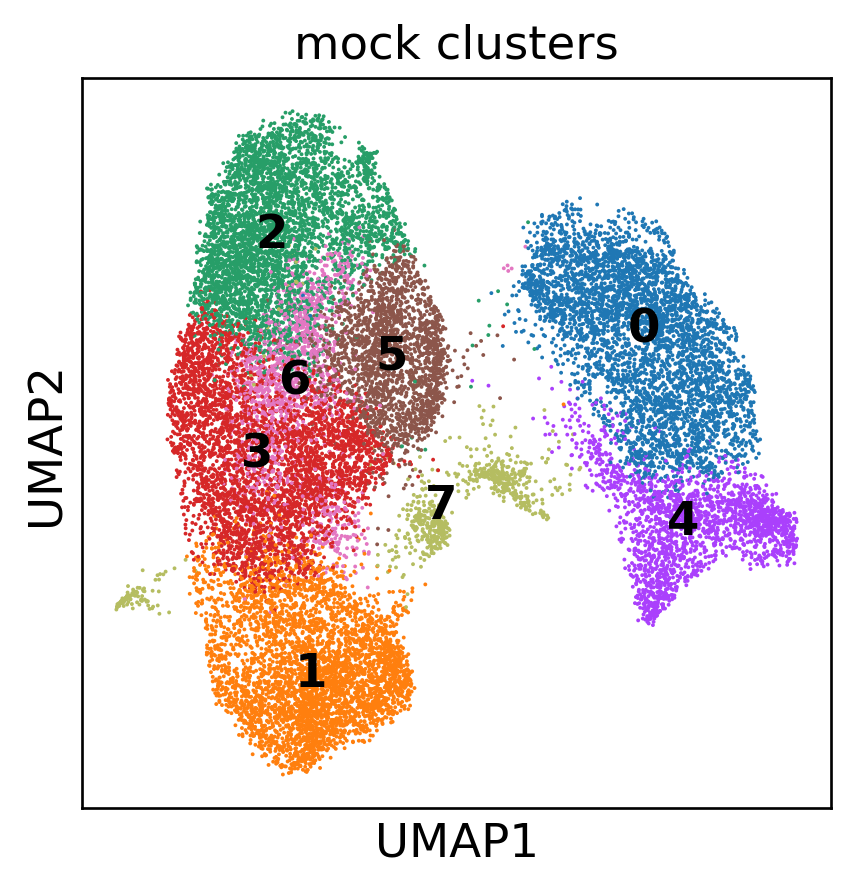

mock genes present: ['ACE2', 'ENO2']


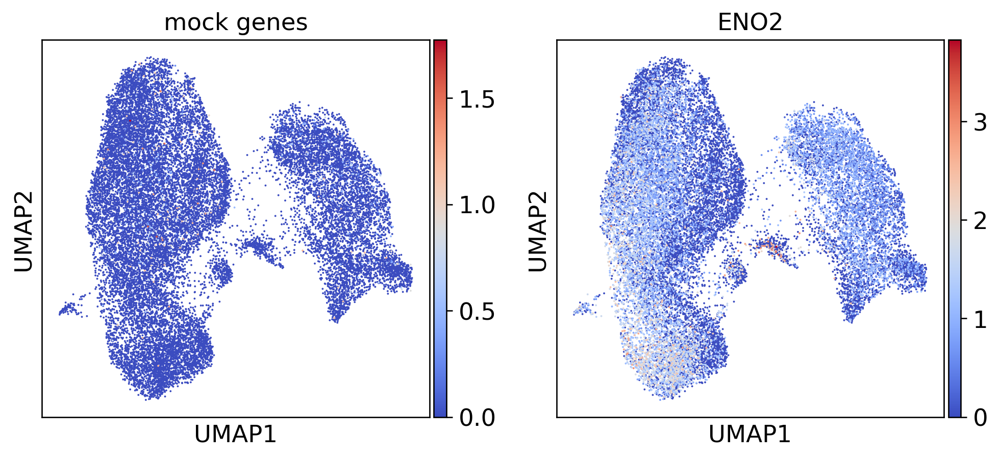

Saved: mock_processed_lowram.h5ad

=== dpi1 ===
Loaded: (11834, 33539)
After early filter: (11279, 19438)


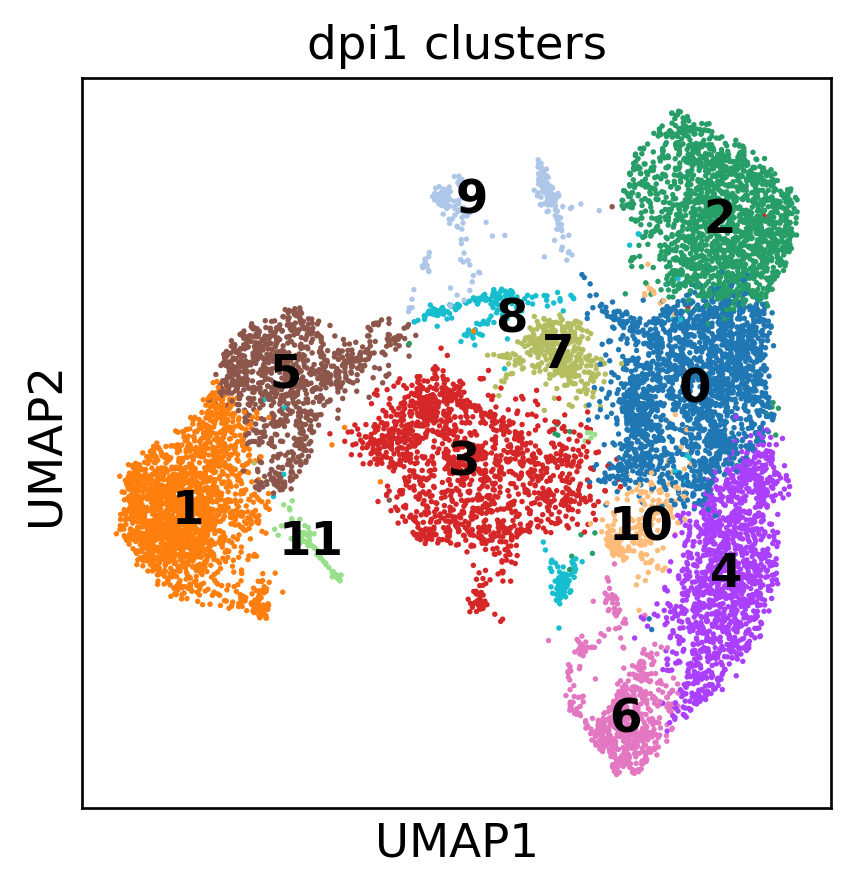

dpi1 genes present: ['ACE2', 'ENO2']


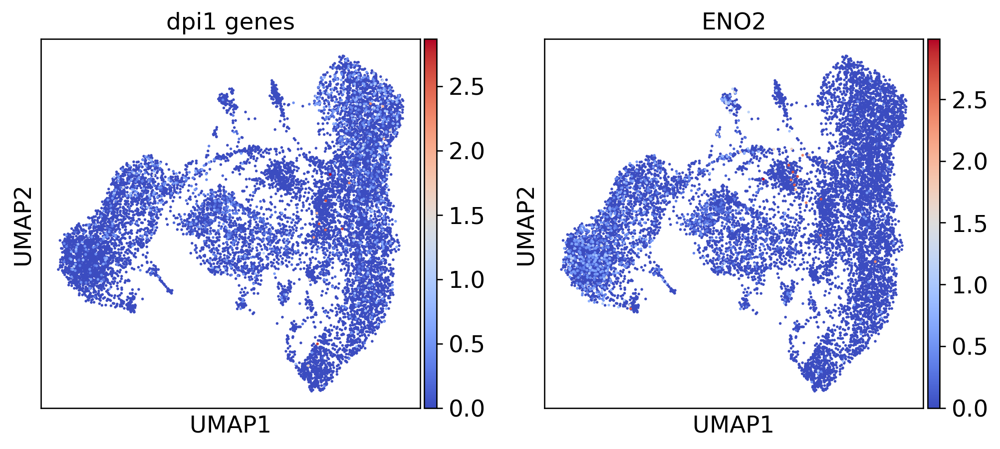

Saved: dpi1_processed_lowram.h5ad

=== dpi2 ===
Loaded: (14695, 33539)
After early filter: (14142, 19670)


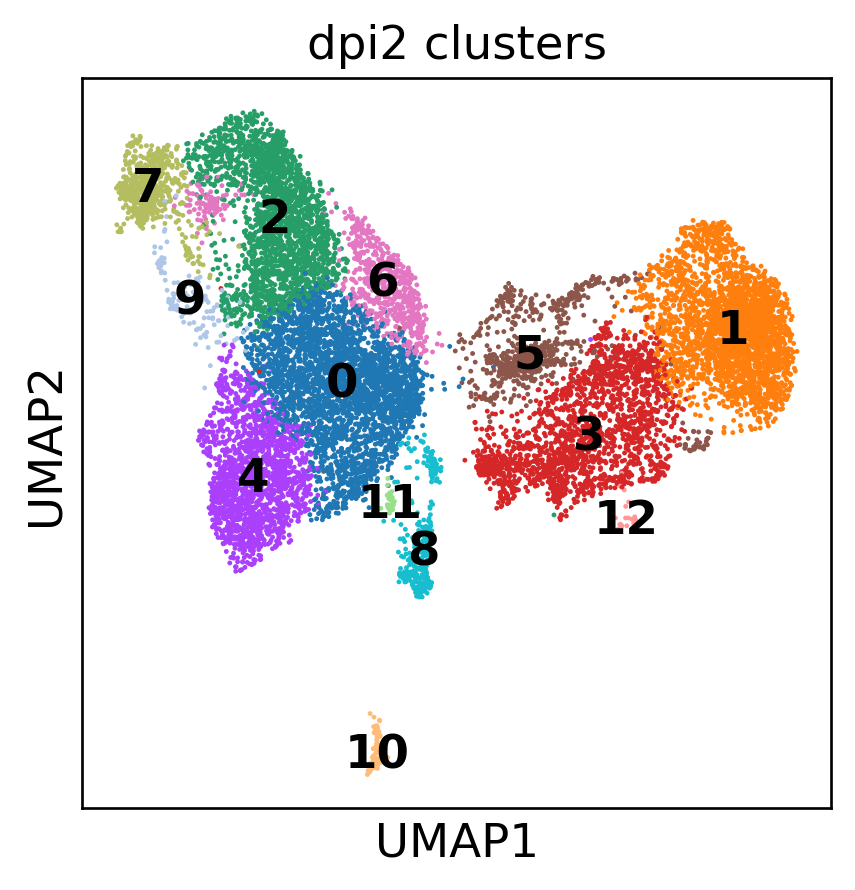

dpi2 genes present: ['ACE2', 'ENO2']


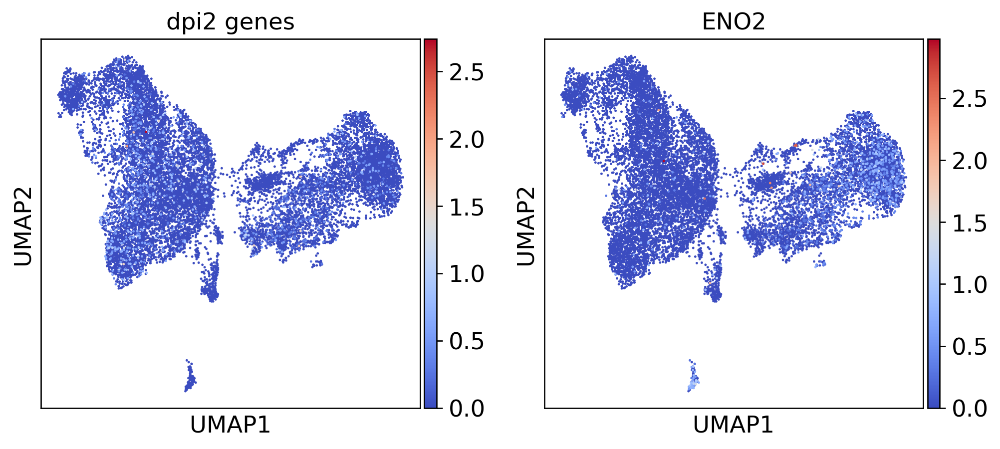

Saved: dpi2_processed_lowram.h5ad

=== dpi3 ===
Loaded: (28530, 33539)
After early filter: (28066, 19666)


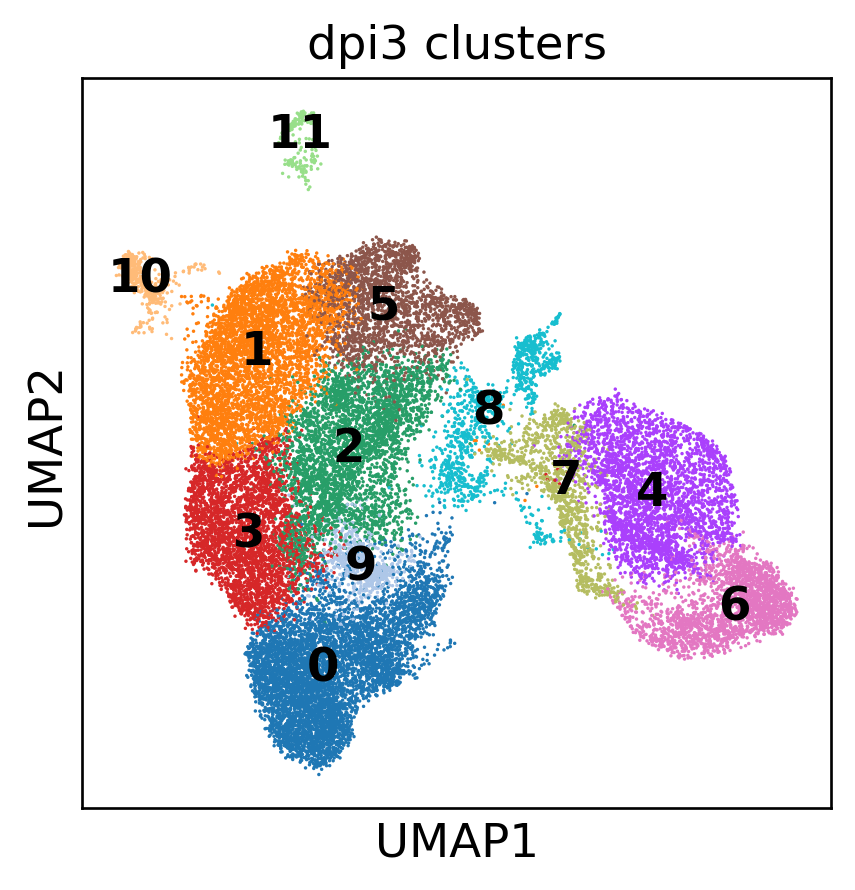

dpi3 genes present: ['ACE2', 'ENO2']


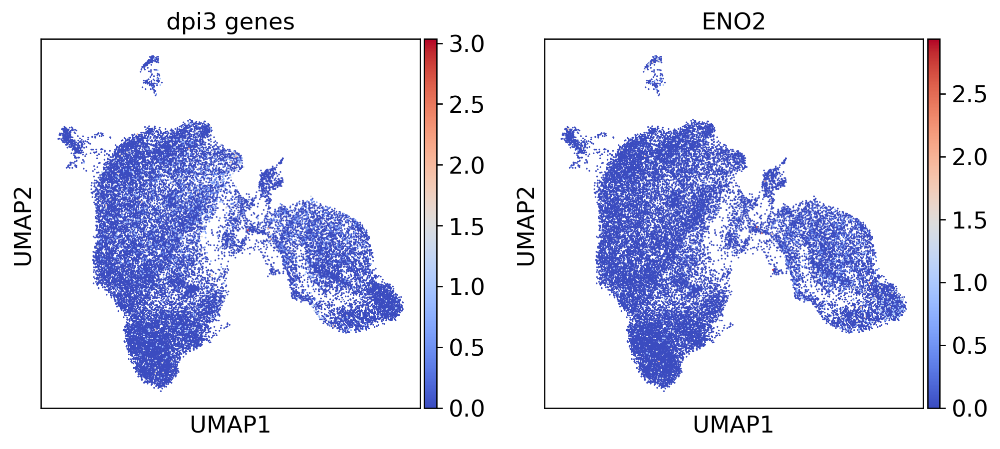

Saved: dpi3_processed_lowram.h5ad
Done.


In [1]:
############################################
# Download and extract GEO supplementary data
############################################

# GEO FTP pattern:
# /geo/series/GSE166nnn/GSE166766/suppl/GSE166766_RAW.tar

# Download the raw supplementary archive quietly
!wget -q -O GSE166766_RAW.tar \
  https://ftp.ncbi.nlm.nih.gov/geo/series/GSE166nnn/GSE166766/suppl/GSE166766_RAW.tar

# Extract the tar archive
!tar -xf GSE166766_RAW.tar

# Inspect extracted contents
!ls -lah


############################################
# Install and import required packages
############################################

# Scanpy is the main dependency; it pulls anndata + plotting stack
!pip -q install scanpy

import os, glob, shutil, gc
import numpy as np
import scanpy as sc
import scipy.sparse as sp

# Scanpy global settings
sc.settings.verbosity = 1           # minimal logging
sc.settings.set_figure_params(dpi=120)  # higher-resolution figures


############################################
# Organize GSM files into per-sample folders
############################################

# Map GSM accession → output directory
samples = {
    "GSM5082289": "GSM5082289_Mock",
    "GSM5082290": "GSM5082290_1dpi",
    "GSM5082291": "GSM5082291_2dpi",
    "GSM5082292": "GSM5082292_3dpi",
}

for gsm, outdir in samples.items():
    os.makedirs(outdir, exist_ok=True)

    # Recursively search for any file containing this GSM ID
    hits = glob.glob(f"**/*{gsm}*.*", recursive=True)

    # Keep only likely 10x Genomics matrix components
    keep = [
        h for h in hits
        if any(k in h for k in ["matrix.mtx", "barcodes.tsv", "features.tsv", "genes.tsv"])
    ]

    print(gsm, "files found:", len(keep))

    # Copy files into the sample-specific directory
    for src in keep:
        dst = os.path.join(outdir, os.path.basename(src))
        if os.path.abspath(src) != os.path.abspath(dst):
            shutil.copy2(src, dst)


############################################
# Standardize 10x file naming conventions
############################################

def standardize_10x_names(folder):
    """
    Renames 10x Genomics files to Scanpy-expected names:
      matrix.mtx(.gz)
      barcodes.tsv(.gz)
      features.tsv(.gz)
    Prefers gzipped versions if available.
    """

    candidates = {
        "matrix": glob.glob(os.path.join(folder, "*matrix.mtx*")),
        "barcodes": glob.glob(os.path.join(folder, "*barcodes.tsv*")),
        "features": (
            glob.glob(os.path.join(folder, "*features.tsv*")) +
            glob.glob(os.path.join(folder, "*genes.tsv*"))
        ),
    }

    def pick_one(files):
        if not files:
            return None
        # Prefer compressed files to save disk/RAM
        gz = [f for f in files if f.endswith(".gz")]
        return gz[0] if gz else files[0]

    matrix = pick_one(candidates["matrix"])
    barcodes = pick_one(candidates["barcodes"])
    features = pick_one(candidates["features"])

    if matrix:
        dst = os.path.join(folder, "matrix.mtx.gz" if matrix.endswith(".gz") else "matrix.mtx")
        if os.path.basename(matrix) != os.path.basename(dst):
            shutil.move(matrix, dst)

    if barcodes:
        dst = os.path.join(folder, "barcodes.tsv.gz" if barcodes.endswith(".gz") else "barcodes.tsv")
        if os.path.basename(barcodes) != os.path.basename(dst):
            shutil.move(barcodes, dst)

    if features:
        dst = os.path.join(folder, "features.tsv.gz" if features.endswith(".gz") else "features.tsv")
        if os.path.basename(features) != os.path.basename(dst):
            shutil.move(features, dst)

# Apply renaming to all sample directories
for outdir in samples.values():
    standardize_10x_names(outdir)


############################################
# Analysis parameters and sample mapping
############################################

SAMPLES = {
    "mock": "GSM5082289_Mock",
    "dpi1": "GSM5082290_1dpi",
    "dpi2": "GSM5082291_2dpi",
    "dpi3": "GSM5082292_3dpi",
}

# Early filtering thresholds (memory-saving)
MIN_CELLS_PER_GENE = 10
MIN_GENES_PER_CELL = 200
MAX_MT_PCT = 20

# Dimensionality reduction / clustering
N_TOP_HVG = 1000
N_PCS = 30
N_NEIGHBORS = 15
LEIDEN_RES = 0.5
LEIDEN_KEY = "leiden_res0_5"

# Genes to visualize on UMAP
GENES_TO_PLOT = ["ACE2", "ENO2"]


############################################
# Helper functions for low-RAM processing
############################################

def read_10x(folder):
    """Read a 10x matrix and ensure unique gene names."""
    ad = sc.read_10x_mtx(folder, var_names="gene_symbols", cache=False)
    ad.var_names_make_unique()
    return ad

def sparse_sum(X, axis):
    """Efficient sum for sparse matrices."""
    return np.asarray(X.sum(axis=axis)).ravel()

def minimal_qc(ad):
    """
    Compute minimal QC metrics without scanpy.pp.calculate_qc_metrics
    to reduce memory usage.
    """
    X = ad.X if sp.issparse(ad.X) else sp.csr_matrix(ad.X)

    ad.obs["total_counts"] = sparse_sum(X, axis=1)
    ad.obs["n_genes_by_counts"] = np.asarray((X > 0).sum(axis=1)).ravel()

    mt_mask = ad.var_names.str.startswith("MT-")
    if mt_mask.any():
        mt_counts = sparse_sum(X[:, mt_mask], axis=1)
        ad.obs["pct_counts_MT"] = (mt_counts / np.maximum(ad.obs["total_counts"], 1e-12)) * 100
    else:
        ad.obs["pct_counts_MT"] = 0.0

def filter_early(ad):
    """
    Early gene and cell filtering to shrink the matrix
    before normalization and HVG selection.
    """
    sc.pp.filter_genes(ad, min_cells=MIN_CELLS_PER_GENE)
    minimal_qc(ad)
    ad = ad[ad.obs["n_genes_by_counts"] >= MIN_GENES_PER_CELL].copy()
    ad = ad[ad.obs["pct_counts_MT"] < MAX_MT_PCT].copy()
    return ad

def normalize_log_lowram(ad):
    """Normalize and log-transform using float32."""
    sc.pp.normalize_total(ad, target_sum=1e4)
    sc.pp.log1p(ad)
    ad.X = ad.X.astype(np.float32)


############################################
# Per-sample analysis pipeline
############################################

def run_one(name, folder):
    print(f"\n=== {name} ===")

    # Load raw counts
    ad = read_10x(folder)
    print("Loaded:", ad.shape)

    # Early filtering (major RAM saver)
    ad = filter_early(ad)
    print("After early filter:", ad.shape)

    # Normalize and log-transform
    normalize_log_lowram(ad)

    # Identify highly variable genes
    sc.pp.highly_variable_genes(ad, n_top_genes=N_TOP_HVG)

    # Work on HVGs only for PCA / neighbors / UMAP
    ad_hvg = ad[:, ad.var["highly_variable"]].copy()

    sc.tl.pca(ad_hvg, n_comps=N_PCS, zero_center=False, svd_solver="randomized")
    sc.pp.neighbors(ad_hvg, n_neighbors=N_NEIGHBORS, n_pcs=N_PCS)
    sc.tl.umap(ad_hvg)
    sc.tl.leiden(ad_hvg, resolution=LEIDEN_RES, key_added=LEIDEN_KEY)

    # Transfer embeddings and clusters back to full object
    ad.obsm["X_umap"] = ad_hvg.obsm["X_umap"]
    ad.obs[LEIDEN_KEY] = ad_hvg.obs[LEIDEN_KEY].values

    # Plot cluster UMAP (image preserved)
    sc.pl.umap(ad, color=[LEIDEN_KEY],
               legend_loc="on data",
               title=f"{name} clusters")

    # Plot gene expression UMAPs (images preserved)
    genes_ok = [g for g in GENES_TO_PLOT if g in ad.var_names]
    print(name, "genes present:", genes_ok)
    if genes_ok:
        sc.pl.umap(ad, color=genes_ok,
                   cmap="coolwarm",
                   title=f"{name} genes")

    # Save processed AnnData
    out = f"{name}_processed_lowram.h5ad"
    ad.write(out)
    print("Saved:", out)

    # Explicit cleanup
    del ad_hvg, ad
    gc.collect()


############################################
# Run pipeline for all samples
############################################

for name, folder in SAMPLES.items():
    run_one(name, folder)

print("Done.")


/usr/local/lib/python3.12/dist-packages/anndata/_core/anndata.py:1796: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


Combined object: (75869, 20622)


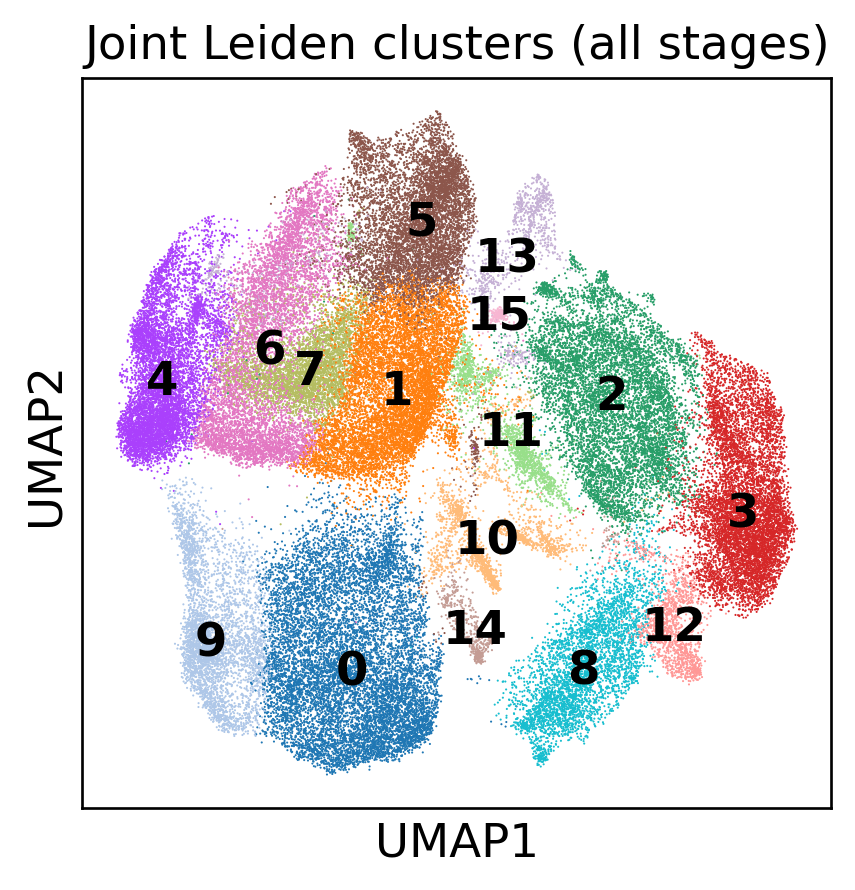

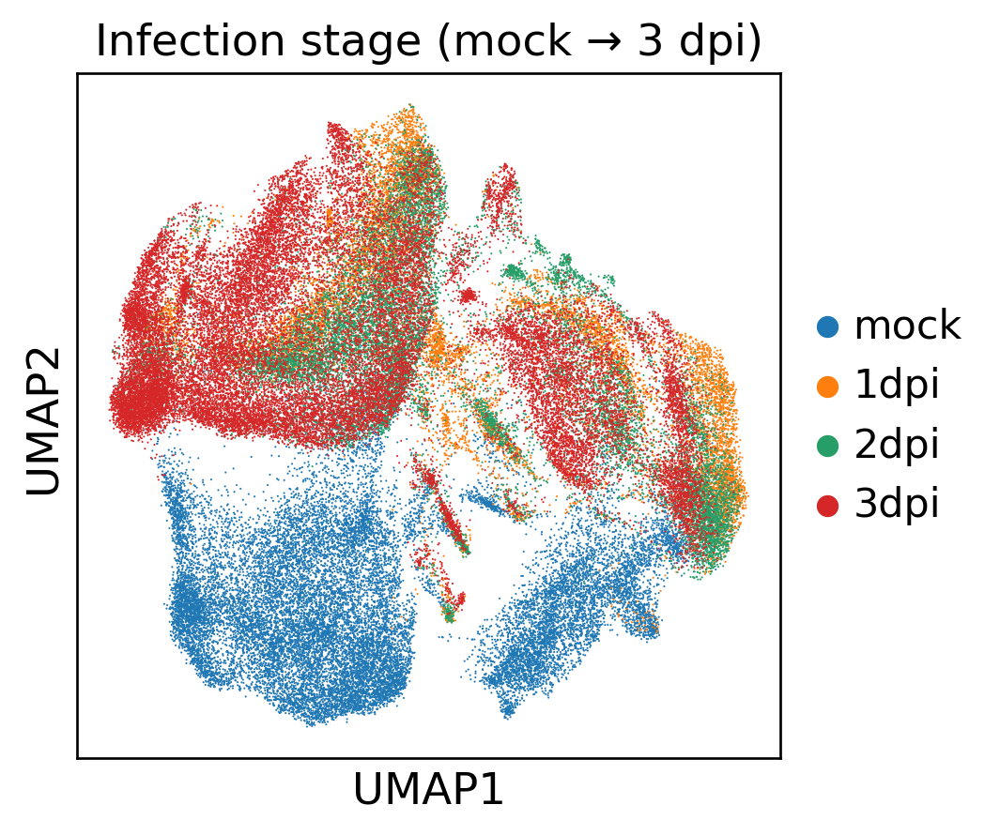

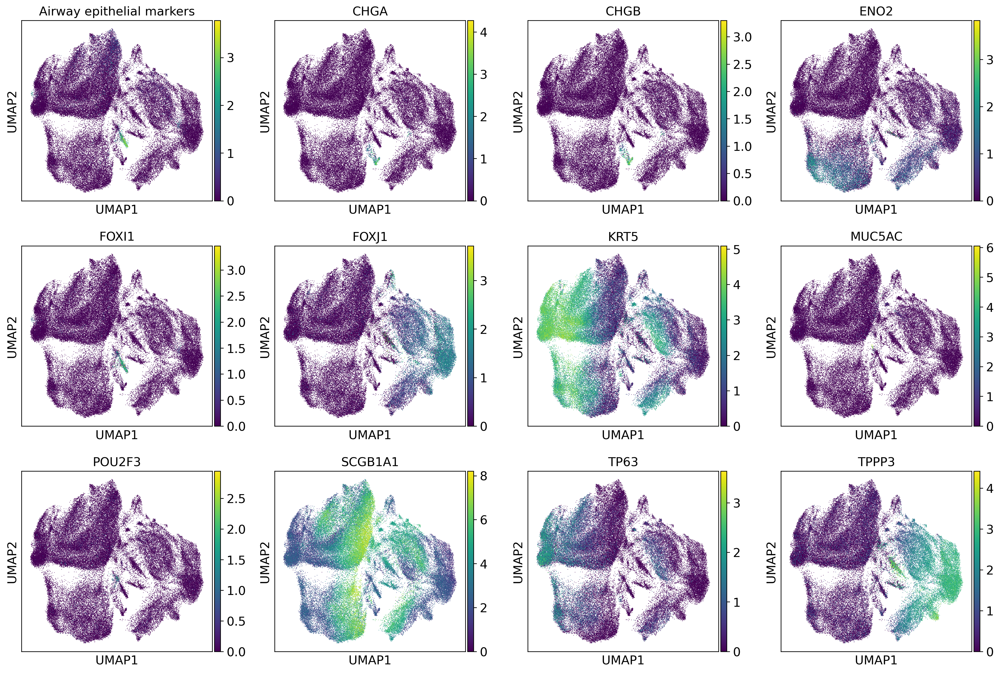

/tmp/ipython-input-1299053650.py:98: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  cluster_means = ad_all.obs.groupby("leiden_joint")[score_cols].mean()


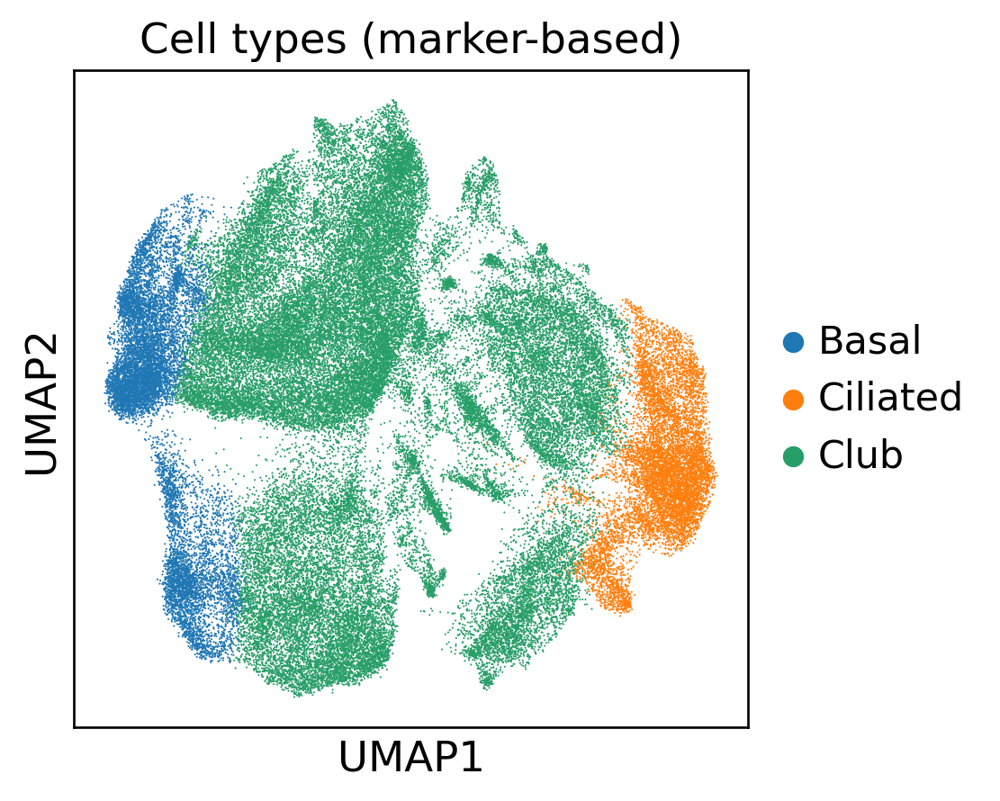

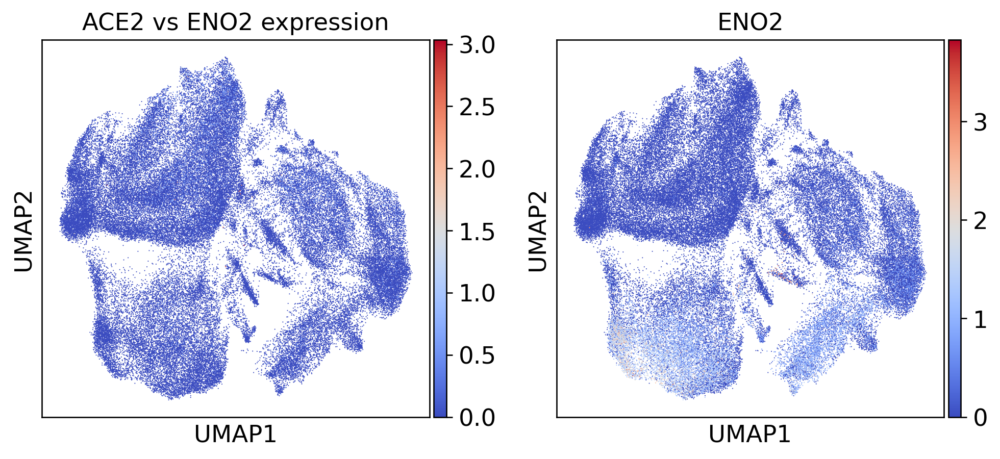

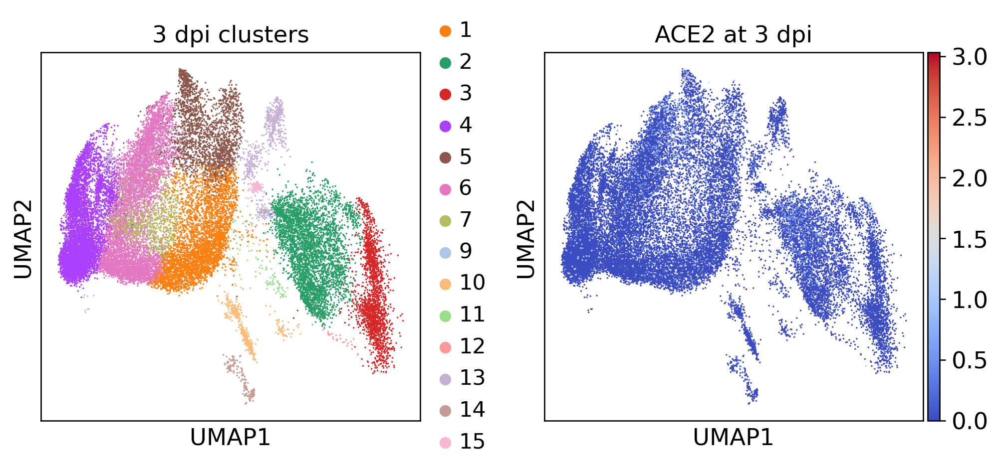


=== ACE2 expression by cluster at 3 dpi ===


/tmp/ipython-input-1299053650.py:129: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  ace2_summary = ad_3dpi.obs.groupby("leiden_joint").agg(


,mean_ACE2,pct_ACE2_pos,n_cells
leiden_joint,,,
5,0.084878,0.091283,2191
2,0.050049,0.089212,4125
7,0.041339,0.054104,1072
6,0.035423,0.052736,6049
15,0.034745,0.034286,175
1,0.033471,0.036228,4030
3,0.030179,0.027833,2012
14,0.029674,0.038251,183
13,0.024661,0.032755,1038


/usr/local/lib/python3.12/dist-packages/scanpy/neighbors/__init__.py:577: UserWarning: You’re trying to run this on 20622 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  x = _choose_representation(self._adata, use_rep=use_rep, n_pcs=n_pcs)


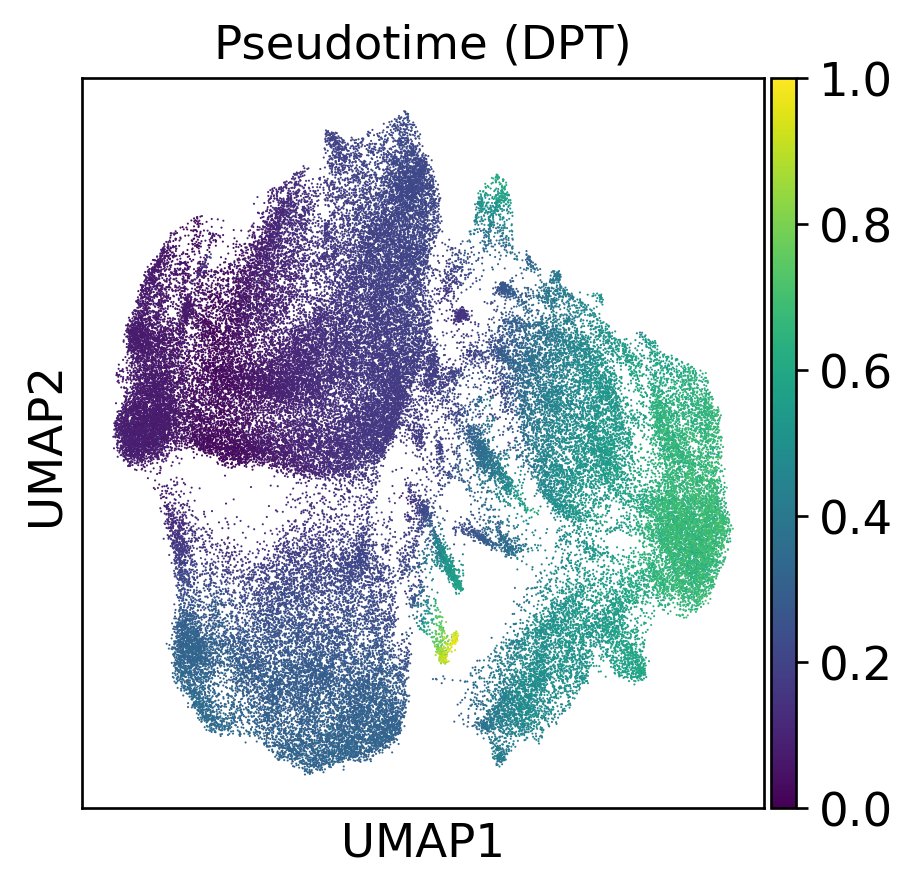


Saved: allstages_joint_annotated.h5ad
All Project 1 analyses completed successfully.


In [3]:
############################################
# Project 1: Joint clustering, cell types,
# ACE2/ENO2 analysis, and pseudotime
############################################

import os, gc
import numpy as np
import scanpy as sc
import scipy.sparse as sp

sc.settings.verbosity = 1
sc.settings.set_figure_params(dpi=120)
sc.settings.figdir = "./figures"
os.makedirs(sc.settings.figdir, exist_ok=True)

############################################
# 1) Load processed datasets
############################################

ad_mock = sc.read_h5ad("mock_processed_lowram.h5ad")
ad_dpi1 = sc.read_h5ad("dpi1_processed_lowram.h5ad")
ad_dpi2 = sc.read_h5ad("dpi2_processed_lowram.h5ad")
ad_dpi3 = sc.read_h5ad("dpi3_processed_lowram.h5ad")

############################################
# 2) Joint concatenation (NO deprecation)
############################################

ad_all = sc.concat(
    {
        "mock": ad_mock,
        "1dpi": ad_dpi1,
        "2dpi": ad_dpi2,
        "3dpi": ad_dpi3
    },
    label="stage",
    join="outer"
)

ad_all.obs_names_make_unique()
ad_all.var_names_make_unique()

print("Combined object:", ad_all.shape)

############################################
# 3) Joint neighborhood clustering
############################################

sc.pp.highly_variable_genes(ad_all, n_top_genes=2000)
ad_hvg = ad_all[:, ad_all.var["highly_variable"]].copy()

sc.tl.pca(ad_hvg, n_comps=50, zero_center=False, svd_solver="randomized")
sc.pp.neighbors(ad_hvg, n_neighbors=15, n_pcs=50)
sc.tl.umap(ad_hvg)
sc.tl.leiden(ad_hvg, resolution=0.5, key_added="leiden_joint")

ad_all.obsm["X_umap"] = ad_hvg.obsm["X_umap"]
ad_all.obs["leiden_joint"] = ad_hvg.obs["leiden_joint"].values

sc.pl.umap(ad_all, color="leiden_joint", legend_loc="on data",
           title="Joint Leiden clusters (all stages)", save="_joint_clusters.png")

sc.pl.umap(ad_all, color="stage",
           title="Infection stage (mock → 3 dpi)", save="_stages.png")

############################################
# 4) Marker-based cell type identification
############################################

MARKERS = {
    "Ciliated": ["FOXJ1", "TPPP3"],
    "Basal": ["KRT5", "TP63"],
    "Club": ["SCGB1A1"],
    "Goblet": ["MUC5AC"],
    "Ionocyte": ["FOXI1", "CFTR"],
    "Tuft": ["POU2F3"],
    "Neuroendocrine": ["CHGA", "CHGB", "ENO2"]
}

# Rank genes per cluster (supports annotation)
sc.tl.rank_genes_groups(ad_all, groupby="leiden_joint", method="wilcoxon")

# Visualize marker expression
marker_genes = sorted({g for v in MARKERS.values() for g in v if g in ad_all.var_names})
sc.pl.umap(ad_all, color=marker_genes, ncols=4,
           title="Airway epithelial markers", save="_marker_panel.png")

# Score each cell for marker sets
for celltype, genes in MARKERS.items():
    genes = [g for g in genes if g in ad_all.var_names]
    if len(genes) > 0:
        sc.tl.score_genes(ad_all, genes, score_name=f"score_{celltype}", use_raw=False)
    else:
        ad_all.obs[f"score_{celltype}"] = 0.0

# Assign cell type per cluster
score_cols = [c for c in ad_all.obs.columns if c.startswith("score_")]
cluster_means = ad_all.obs.groupby("leiden_joint")[score_cols].mean()
cluster_to_type = cluster_means.idxmax(axis=1).str.replace("score_", "", regex=False)

ad_all.obs["cell_type"] = ad_all.obs["leiden_joint"].map(cluster_to_type).astype("category")

sc.pl.umap(ad_all, color="cell_type", legend_loc="right margin",
           title="Cell types (marker-based)", save="_cell_types.png")

############################################
# 5) ACE2 vs ENO2 analysis
############################################

genes_present = [g for g in ["ACE2", "ENO2"] if g in ad_all.var_names]

if genes_present:
    sc.pl.umap(ad_all, color=genes_present, cmap="coolwarm",
               title="ACE2 vs ENO2 expression", save="_ACE2_ENO2.png")

# ACE2 at 3 dpi
if "ACE2" in ad_all.var_names:
    ad_3dpi = ad_all[ad_all.obs["stage"] == "3dpi"].copy()

    sc.pl.umap(ad_3dpi, color=["leiden_joint", "ACE2"], cmap="coolwarm",
               title=["3 dpi clusters", "ACE2 at 3 dpi"],
               save="_3dpi_ACE2.png")

    X = ad_3dpi[:, "ACE2"].X
    ace2 = np.asarray(X.todense()).ravel() if sp.issparse(X) else np.asarray(X).ravel()
    ad_3dpi.obs["ACE2_value"] = ace2
    ad_3dpi.obs["ACE2_pos"] = ace2 > 0

    ace2_summary = ad_3dpi.obs.groupby("leiden_joint").agg(
        mean_ACE2=("ACE2_value", "mean"),
        pct_ACE2_pos=("ACE2_pos", "mean"),
        n_cells=("ACE2_value", "size")
    ).sort_values("mean_ACE2", ascending=False)

    print("\n=== ACE2 expression by cluster at 3 dpi ===")
    display(ace2_summary)

############################################
# 6) Pseudotime analysis (Diffusion Pseudotime)
############################################

sc.pp.neighbors(ad_all, n_neighbors=15, n_pcs=50)
sc.tl.diffmap(ad_all)

# Root: basal-like cells (progenitor)
if "score_Basal" in ad_all.obs.columns:
    ad_all.uns["iroot"] = int(np.argmax(ad_all.obs["score_Basal"].values))

sc.tl.dpt(ad_all)

sc.pl.umap(ad_all, color="dpt_pseudotime",
           title="Pseudotime (DPT)", save="_pseudotime.png")

############################################
# 7) Save final object
############################################

ad_all.write("allstages_joint_annotated.h5ad")
print("\nSaved: allstages_joint_annotated.h5ad")
print("All Project 1 analyses completed successfully.")
